In [4]:
!pip install geopy

In [5]:
!pip install pyspark

     |████████████████████████████████| 212.3MB 72kB/s 
     |████████████████████████████████| 204kB 50.8MB/s 
  Created wheel for pyspark: filename=pyspark-3.1.1-py2.py3-none-any.whl size=212767604 sha256=8124c417261bca1fcf45e1132ccf087050479c0f40d8e72fbfd440c1ba4b55b5
  Stored in directory: /root/.cache/pip/wheels/0b/90/c0/01de724414ef122bd05f056541fb6a0ecf47c7ca655f8b3c0f
Successfully built pyspark


In [6]:
import pyspark
from pyspark.sql import SparkSession
from pyspark.sql.functions import col, split, lit, exp
from pyspark.sql.types import StructType, StructField, StringType, IntegerType, DoubleType
from pyspark import SparkContext
from pyspark.sql import SQLContext
import pandas as pd
import re
from geopy.geocoders import Nominatim
from geopy.extra.rate_limiter import RateLimiter
from geopy.distance import geodesic
#from operator import itemgetter, attrgetter
# create SparkSession
spark = SparkSession.builder.master("local[*]") \
                    .appName('SparkSNCF') \
                    .getOrCreate()
#extract SparkContext
sc = spark.sparkContext
#sqlContext = SQLContext(sc)

print('Spark CPU usage :', sc.defaultParallelism)

Spark CPU usage : 2


 ## 2. Etablissez à l'aide du module python geopy un classement descendant des distances pour chaque trajets possible

## FONCTION PERMETTANT DE CALULER LA DISTANCE D'UN TRAJET ENTRE DEUX NOMS GARES

In [7]:
def calcul_distance(trajet):   
    geolocator = Nominatim(user_agent='class-app', timeout=10)
    geocode = RateLimiter(geolocator.geocode, min_delay_seconds=1/20)
    gare1= geolocator.geocode(trajet[0])
    gare2= geolocator.geocode(trajet[1])
    if gare1 != None and gare2 != None:
        gare1 = (gare1.latitude, gare1.longitude)
        gare2 = (gare2.latitude, gare2.longitude)
        distance = (geodesic(gare1, gare2).km)
        trajet = str(trajet[0]) + "-" + str(trajet[1])
        return [str(trajet), float(distance)]
    return None


In [9]:
def distance_trajet(trajet):   
    geolocator = Nominatim(user_agent='class-app', timeout=10)
    geocode = RateLimiter(geolocator.geocode, min_delay_seconds=1/20)
    gare1= geolocator.geocode(trajet[0])
    gare2= geolocator.geocode(trajet[1])
    if gare1 != None and gare2 != None:
        gare1 = (gare1.latitude, gare1.longitude)
        gare2 = (gare2.latitude, gare2.longitude)
        distance = []
        distance = (geodesic(gare1, gare2).km)
        trajet = str(trajet[0]) + "-" + str(trajet[1])
        dist = []
        for i in trajet:
            if len(i) != 2:
                dist.append(None)
            else:
                dist.append(distance(i))
        return distance
    else:
      
      return None

## AFFICHAGE DE NOTRE DATAFRAME

In [11]:
df_spark = spark.read.option("delimiter", ";").option("header", True).csv("data/tarifs-tgv-par-od.csv")
df_spark.show()
df_spark.count()

+--------------------+------------------+-----------------------+-----------+------------+
|                  OD|Prix d'appel 2nde |Plein Tarif Loisir 2nde|1ère classe|Commentaires|
+--------------------+------------------+-----------------------+-----------+------------+
|  NIMES-LILLE EUROPE|              30.0|                  144.0|      184.0|        null|
|MOUTIERS SALINS B...|              30.0|                  147.0|      190.0|        null|
|      LANDRY-QUIMPER|              30.0|                  147.0|      190.0|        null|
|TGV HAUTE PICARDI...|              30.0|                  150.0|      188.0|        null|
|TGV HAUTE PICARDI...|              30.0|                  150.0|      188.0|        null|
|PARIS GARE DE LYO...|              25.0|                  121.0|      166.0|        null|
|PARIS GARE DE LYO...|              25.0|                   88.0|      119.0|        null|
|LIMOGES BENEDICTI...|              25.0|                   88.0|      111.0|        null|

998

## CREATION D'UN SCHEMA POUR MODIFIER L'ENTETE DE NOTRE DATAFRAME ET FAIRE UNE LISTE DES PRIX

In [12]:
schema = StructType([\
    StructField("Trajet", StringType()),\
    StructField("Pris_appel_2nd", DoubleType()), \
    StructField("Lein_tarif_loisir_2nd", DoubleType()),\
    StructField("Prix1classe", DoubleType()),\
    StructField("Commentaire", StringType()),\
])

sdfData = spark.read.csv("data/tarifs-tgv-par-od.csv", header=True, sep=";", schema=schema)
df_spark2 = sdfData.select(sdfData.Prix1classe).drop("Pris_appel_2nd", "Lein_tarif_loisir_2nd", "Commentaire")
names = df_spark2.select("Prix1classe").collect()
liste_prix = []
for i in names:
    liste_prix.append(i.Prix1classe)
    
print(liste_prix)


[184.0, 190.0, 190.0, 188.0, 188.0, 166.0, 119.0, 111.0, 86.0, 136.0, 136.0, 136.0, 151.0, 53.0, 119.0, 155.0, 148.0, 81.0, 81.0, 154.0, 154.0, 161.0, 149.0, 154.0, 140.0, 152.0, 143.0, 144.0, 125.0, 46.0, 135.0, 67.0, 68.0, 89.0, 182.0, 193.0, 132.0, 85.0, 97.0, 180.0, 142.0, 120.0, 96.0, 7.8, 9.5, 11.9, 14.7, 17.0, 16.0, 17.5, 17.5, 19.5, 19.5, 20.0, 26.0, 31.0, 32.0, 33.0, 36.0, 37.0, 38.0, 41.0, 38.0, 43.0, 44.0, 47.0, 53.0, 53.0, 53.0, 54.0, 54.0, 58.0, 64.0, 65.0, 65.0, 66.0, 84.0, 86.0, 101.0, 102.0, 122.0, 69.0, 61.0, 42.0, 160.0, 133.0, 112.0, 112.0, 161.0, 146.0, 111.0, 123.0, 107.0, 150.0, 140.0, 126.0, 123.0, 28.5, 51.0, 54.0, 58.0, 101.0, 73.0, 131.0, 133.0, 161.0, 153.0, 153.0, 133.0, 107.0, 130.0, 173.0, 107.0, 128.0, 47.0, 44.0, 47.0, 47.0, 67.0, 63.0, 64.0, 82.0, 72.0, 76.0, 77.0, 88.0, 101.0, 111.0, 121.0, 125.0, 134.0, 139.0, 143.0, 148.0, 149.0, 153.0, 158.0, 165.0, 165.0, 165.0, 165.0, 167.0, 167.0, 167.0, 167.0, 167.0, 167.0, 167.0, 167.0, 167.0, 177.0, 160.0, 170

## CREATION D'UNE LISTE DES DISTANCES

In [13]:
#sdfData = spark.read.csv("data/tarifs-tgv-par-od.csv", header=True, sep=";", schema=schema)
#df_spark2 = sdfData.select("Trajet").drop("Pris_appel_2nd", "Lein_tarif_loisir_2nd", "Commentaire")
namesTrajet = sdfData.select("Trajet").collect()

liste_distance = []
for i in namesTrajet:
    liste_distance.append(i.Trajet.split("-"))

tab_distance = []  
for i in liste_distance:
    tab_distance.append(distance_trajet(i))
    print(tab_distance)
    

[762.4040500371942]
[762.4040500371942, 858.3584027131074]
[762.4040500371942, 858.3584027131074, 869.8941037108304]
[762.4040500371942, 858.3584027131074, 869.8941037108304, 729.3019723077787]
[762.4040500371942, 858.3584027131074, 869.8941037108304, 729.3019723077787, 720.8870438873681]
[762.4040500371942, 858.3584027131074, 869.8941037108304, 729.3019723077787, 720.8870438873681, 692.6562359132587]
[762.4040500371942, 858.3584027131074, 869.8941037108304, 729.3019723077787, 720.8870438873681, 692.6562359132587, 360.8714416783739]
[762.4040500371942, 858.3584027131074, 869.8941037108304, 729.3019723077787, 720.8870438873681, 692.6562359132587, 360.8714416783739, None]
[762.4040500371942, 858.3584027131074, 869.8941037108304, 729.3019723077787, 720.8870438873681, 692.6562359132587, 360.8714416783739, None, None]
[762.4040500371942, 858.3584027131074, 869.8941037108304, 729.3019723077787, 720.8870438873681, 692.6562359132587, 360.8714416783739, None, None, 447.0743280019601]
[762.40405

## LISTE DES TRAJETS POSSIBLES

In [14]:
#df_spark = spark.read.option("delimiter", ";").option("header", True).csv("data/tarifs-tgv-par-od.csv")
names = sdfData.select("Trajet").collect()
liste = []
for i in names:
    liste.append(i.Trajet)
 

print(liste)



['NIMES-LILLE EUROPE', 'MOUTIERS SALINS BRIDES-QUIMPER', 'LANDRY-QUIMPER', 'TGV HAUTE PICARDIE-AGDE', 'TGV HAUTE PICARDIE-SETE', 'PARIS GARE DE LYON-TOULON', 'PARIS GARE DE LYON-MONTBELIARD', 'LIMOGES BENEDICTINS-AEROPORT CDG 2 TGV ROISSY', 'CHATEAUROUX-AEROPORT CDG 2 TGV ROISSY', 'CHAMBERY CHALLES LES EAUX-MASSY TGV', 'MASSY TGV-AIX LES BAINS LE REVARD', 'AEROPORT CDG 2 TGV ROISSY-AIX LES BAINS LE REVARD', 'NICE VILLE-CHALON SUR SAONE', 'BELFORT-MONTBELIARD TGV-LONS LE SAUNIER', 'MARSEILLE ST CHARLES-LONS LE SAUNIER', 'BESANCON VIOTTE-LILLE EUROPE', 'ANGERS ST LAUD-NANCY VILLE', 'LE MANS-PARIS MONTPARNASSE 1 ET 2', 'LE MANS-MASSY TGV', 'AEROPORT CDG 2 TGV ROISSY-ALBERTVILLE', 'PARIS NORD-ALBERTVILLE', 'MARNE LA VALLEE CHESSY-BOURG ST MAURICE', 'ST JEAN DE MAURIENNE ARVAN-MARNE LA VALLEE CHESSY', 'MARNE LA VALLEE CHESSY-ST MICHEL VALLOIRE', 'MARNE LA VALLEE CHESSY-ANNECY', 'MASSY TGV-ANNEMASSE', 'MASSY PALAISEAU-VALENCE', 'LE TEIL-PARIS GARE DE LYON', 'PARIS EST-ST DIE', 'MEUSE-LUNEVIL

## CALCUL DE LA DISTANCE DES TRAJETS POSSIBLES ET AFFICHAGE DE LA LISTE (TRAJET, DISTANCE)

In [27]:
def calcul_distance_none(trajets):   
    geolocator = Nominatim(user_agent='class-app', timeout=10)
    geocode = RateLimiter(geolocator.geocode, min_delay_seconds=1/20)
    gare_1= geolocator.geocode(trajets[0])
    gare_2= geolocator.geocode(trajets[1])
    if gare_1 != None and gare_2 != None:
        gare_1 = (gare_1.latitude, gare_1.longitude)
        gare_2 = (gare_2.latitude, gare_2.longitude)
        distance_l = (geodesic(gare_1, gare_2).km)
        trajets = str(trajets[0]) + "-" + str(trajets[1])
        return [trajets, float(distance_l)]
    else:
        gare_1 = 0
        gare_2 = 0
        distance_l = 0
        trajets = str(trajets[0]) + "-" + str(trajets[1])
        return trajets, int(distance_l)
names = sdfData.select("Trajet").collect()
liste = []
for i in names:
    if len(i.Trajet.split("-")) == 2:
        liste.append(i.Trajet.split("-"))
#print(liste)
ma_liste_trajet_distance = []
for i in liste:
    ma_liste_trajet_distance.append(calcul_distance_none(i))
    print(ma_liste_trajet_distance)

[['NIMES-LILLE EUROPE', 762.4040500371942]]
[['NIMES-LILLE EUROPE', 762.4040500371942], ['MOUTIERS SALINS BRIDES-QUIMPER', 858.3584027131074]]
[['NIMES-LILLE EUROPE', 762.4040500371942], ['MOUTIERS SALINS BRIDES-QUIMPER', 858.3584027131074], ['LANDRY-QUIMPER', 869.8941037108304]]
[['NIMES-LILLE EUROPE', 762.4040500371942], ['MOUTIERS SALINS BRIDES-QUIMPER', 858.3584027131074], ['LANDRY-QUIMPER', 869.8941037108304], ['TGV HAUTE PICARDIE-AGDE', 729.3019723077787]]
[['NIMES-LILLE EUROPE', 762.4040500371942], ['MOUTIERS SALINS BRIDES-QUIMPER', 858.3584027131074], ['LANDRY-QUIMPER', 869.8941037108304], ['TGV HAUTE PICARDIE-AGDE', 729.3019723077787], ['TGV HAUTE PICARDIE-SETE', 720.8870438873681]]
[['NIMES-LILLE EUROPE', 762.4040500371942], ['MOUTIERS SALINS BRIDES-QUIMPER', 858.3584027131074], ['LANDRY-QUIMPER', 869.8941037108304], ['TGV HAUTE PICARDIE-AGDE', 729.3019723077787], ['TGV HAUTE PICARDIE-SETE', 720.8870438873681], ['PARIS GARE DE LYON-TOULON', 692.6562359132587]]
[['NIMES-LILLE 

## CLASSER DANS L'ORDRE DECROISSANT

In [29]:
ma_liste_trajet_distance

[['NIMES-LILLE EUROPE', 762.4040500371942],
 ['MOUTIERS SALINS BRIDES-QUIMPER', 858.3584027131074],
 ['LANDRY-QUIMPER', 869.8941037108304],
 ['TGV HAUTE PICARDIE-AGDE', 729.3019723077787],
 ['TGV HAUTE PICARDIE-SETE', 720.8870438873681],
 ['PARIS GARE DE LYON-TOULON', 692.6562359132587],
 ['PARIS GARE DE LYON-MONTBELIARD', 360.8714416783739],
 ('LIMOGES BENEDICTINS-AEROPORT CDG 2 TGV ROISSY', 0),
 ('CHATEAUROUX-AEROPORT CDG 2 TGV ROISSY', 0),
 ['CHAMBERY CHALLES LES EAUX-MASSY TGV', 447.0743280019601],
 ['MASSY TGV-AIX LES BAINS LE REVARD', 436.2633303716542],
 ('AEROPORT CDG 2 TGV ROISSY-AIX LES BAINS LE REVARD', 0),
 ['NICE VILLE-CHALON SUR SAONE', 391.41512758445083],
 ['MARSEILLE ST CHARLES-LONS LE SAUNIER', 374.71325108258884],
 ['BESANCON VIOTTE-LILLE EUROPE', 434.55502456335773],
 ['ANGERS ST LAUD-NANCY VILLE', 519.5196024578538],
 ['LE MANS-PARIS MONTPARNASSE 1 ET 2', 182.54463734099187],
 ['LE MANS-MASSY TGV', 172.5723940507855],
 ('AEROPORT CDG 2 TGV ROISSY-ALBERTVILLE', 0),


In [30]:
sorted(ma_liste_trajet_distance, key = lambda x: int(x[1]), reverse=True)

[['TOULON-ORANGE', 9760.727032347975],
 ['MIRAMAS-ORANGE', 9671.941837997054],
 ['VALENCE-ORANGE', 9666.496907902658],
 ['ARLES-ORANGE', 9643.411814320272],
 ['LYON PART DIEU-ORANGE', 9491.196710004026],
 ['MACON LOCHE TGV-ORANGE', 9445.444620837034],
 ['LE MANS-SABLE', 7342.39947292682],
 ['ANGERS ST LAUD-SABLE', 7298.936708789214],
 ['ANCENIS-SABLE', 7254.798679916018],
 ['SABLE-LA ROCHE SUR YON', 7251.176691127758],
 ["LES SABLES D'OLONNE-SABLE", 7227.278331829524],
 ['PORNICHET-SABLE', 7171.056659015029],
 ['LE CROISIC-SABLE', 7157.543647147226],
 ['LE HAVRE-MEUSE', 3595.1096622652904],
 ['MEUSE-ST PIERRE DES CORPS', 3426.5396618407135],
 ['MASSY TGV-MEUSE', 3417.7451614949246],
 ['MEUSE-THIONVILLE', 3245.645429438339],
 ['MEUSE-LORRAINE TGV', 3214.122797747466],
 ['MEUSE-NANCY VILLE', 3194.3466250837355],
 ['MEUSE-LUNEVILLE', 3169.778002962707],
 ['MEUSE-SAVERNE', 3135.2830573117444],
 ['MEUSE-REMIREMONT', 3120.7941109745375],
 ['LILLE FLANDRES-VALENCE', 1269.963323236889],
 ['ROU

## liste de tous les trajets possibles, distance et prix : Trajet, Distance, Prix en 1ère classe 

In [32]:
tot_list = []
for i in range(len(liste)):
    temp = [liste[i],tab_distance[i],liste_prix[i]]
    tot_list.append(temp)
    
    
    
print(tot_list)

[[['NIMES', 'LILLE EUROPE'], 762.4040500371942, 184.0], [['MOUTIERS SALINS BRIDES', 'QUIMPER'], 858.3584027131074, 190.0], [['LANDRY', 'QUIMPER'], 869.8941037108304, 190.0], [['TGV HAUTE PICARDIE', 'AGDE'], 729.3019723077787, 188.0], [['TGV HAUTE PICARDIE', 'SETE'], 720.8870438873681, 188.0], [['PARIS GARE DE LYON', 'TOULON'], 692.6562359132587, 166.0], [['PARIS GARE DE LYON', 'MONTBELIARD'], 360.8714416783739, 119.0], [['LIMOGES BENEDICTINS', 'AEROPORT CDG 2 TGV ROISSY'], None, 111.0], [['CHATEAUROUX', 'AEROPORT CDG 2 TGV ROISSY'], None, 86.0], [['CHAMBERY CHALLES LES EAUX', 'MASSY TGV'], 447.0743280019601, 136.0], [['MASSY TGV', 'AIX LES BAINS LE REVARD'], 436.2633303716542, 136.0], [['AEROPORT CDG 2 TGV ROISSY', 'AIX LES BAINS LE REVARD'], None, 136.0], [['NICE VILLE', 'CHALON SUR SAONE'], 391.41512758445083, 151.0], [['MARSEILLE ST CHARLES', 'LONS LE SAUNIER'], 6.35088795193229, 53.0], [['BESANCON VIOTTE', 'LILLE EUROPE'], 374.71325108258884, 119.0], [['ANGERS ST LAUD', 'NANCY VILL

## 3- Création de ma Dataframe listant tous les trajets possibles avec 3 colonnes : Trajet, Distance, Prix en 1ère classe

In [33]:
from pyspark.sql.types import *

cSchema = StructType([StructField("Trajet", StringType())\
                      ,StructField("Distance", DoubleType())\
                      ,StructField("Prix", DoubleType())])

df = spark.createDataFrame(tot_list,schema=cSchema)
df.printSchema()
df.show(20)
df.count()

root
 |-- Trajet: string (nullable = true)
 |-- Distance: double (nullable = true)
 |-- Prix: double (nullable = true)

+--------------------+------------------+-----+
|              Trajet|          Distance| Prix|
+--------------------+------------------+-----+
|[NIMES, LILLE EUR...| 762.4040500371942|184.0|
|[MOUTIERS SALINS ...| 858.3584027131074|190.0|
|   [LANDRY, QUIMPER]| 869.8941037108304|190.0|
|[TGV HAUTE PICARD...| 729.3019723077787|188.0|
|[TGV HAUTE PICARD...| 720.8870438873681|188.0|
|[PARIS GARE DE LY...| 692.6562359132587|166.0|
|[PARIS GARE DE LY...| 360.8714416783739|119.0|
|[LIMOGES BENEDICT...|              null|111.0|
|[CHATEAUROUX, AER...|              null| 86.0|
|[CHAMBERY CHALLES...| 447.0743280019601|136.0|
|[MASSY TGV, AIX L...| 436.2633303716542|136.0|
|[AEROPORT CDG 2 T...|              null|136.0|
|[NICE VILLE, CHAL...|391.41512758445083|151.0|
|[MARSEILLE ST CHA...|  6.35088795193229| 53.0|
|[BESANCON VIOTTE,...|374.71325108258884|119.0|
|[ANGERS ST LAUD

974

## Nettoyage de notre DataFrame avec la fonction drop : on supprime toutes les lignes contenant une valeur null dans notre dataFrame

In [34]:
New_df=df.na.drop(subset=['Distance'])
New_df.show(50)
New_df.count()

+--------------------+------------------+-----+
|              Trajet|          Distance| Prix|
+--------------------+------------------+-----+
|[NIMES, LILLE EUR...| 762.4040500371942|184.0|
|[MOUTIERS SALINS ...| 858.3584027131074|190.0|
|   [LANDRY, QUIMPER]| 869.8941037108304|190.0|
|[TGV HAUTE PICARD...| 729.3019723077787|188.0|
|[TGV HAUTE PICARD...| 720.8870438873681|188.0|
|[PARIS GARE DE LY...| 692.6562359132587|166.0|
|[PARIS GARE DE LY...| 360.8714416783739|119.0|
|[CHAMBERY CHALLES...| 447.0743280019601|136.0|
|[MASSY TGV, AIX L...| 436.2633303716542|136.0|
|[NICE VILLE, CHAL...|391.41512758445083|151.0|
|[MARSEILLE ST CHA...|  6.35088795193229| 53.0|
|[BESANCON VIOTTE,...|374.71325108258884|119.0|
|[ANGERS ST LAUD, ...|434.55502456335773|155.0|
|[LE MANS, PARIS M...| 519.5196024578538|148.0|
|[LE MANS, MASSY TGV]|182.54463734099187| 81.0|
|[AEROPORT CDG 2 T...| 172.5723940507855| 81.0|
|[MARNE LA VALLEE ...| 604.2274280346617|154.0|
|[ST JEAN DE MAURI...| 470.8042433848519

912

## 4. Représentation graphique mettant en avant la corrélation entre le prix et la distance pour chaque trajet possible

In [36]:
df_trajet = New_df.select("Distance").drop("Trajet", "Prix")
nameDistance = df_trajet.select("Distance").collect()


Liste_des_distances_plt = []
for i in nameDistance:
    Liste_des_distances_plt.append(i.Distance)

#print(Liste_des_distances_plt)
#Liste_des_distances_plt

In [37]:
df_prix = New_df.select("Prix").drop("Trajet", "Distance")
namePrix = df_prix.select("Prix").collect()
#df_prix.show()

Liste_des_prix_plt = []
for i in namePrix:
    Liste_des_prix_plt.append(i.Prix)

#print(Liste_des_prix_plt)

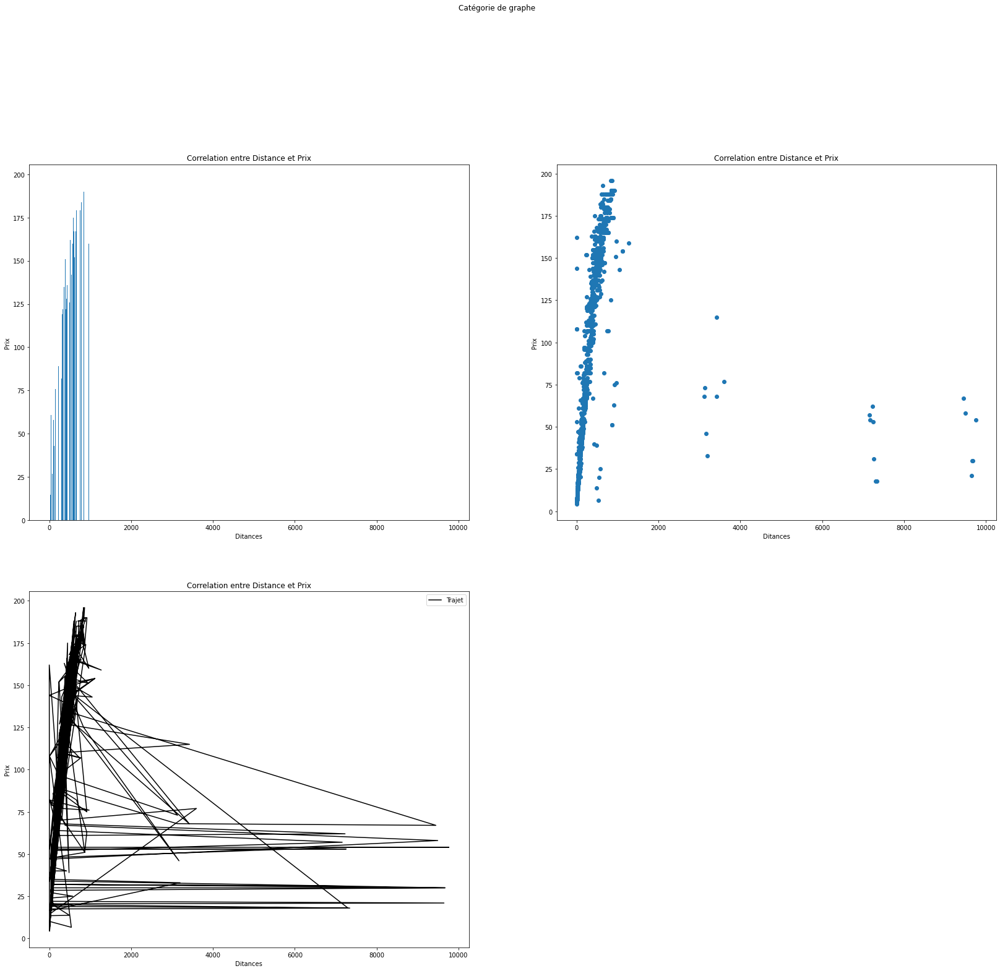

In [38]:
import matplotlib.pyplot as plt 

plt.figure(figsize=(28, 36))
plt.subplot(321)
plt.bar(Liste_des_distances_plt, Liste_des_prix_plt)
plt.title("Correlation entre Distance et Prix")
plt.xlabel("Ditances")
plt.ylabel("Prix")
plt.subplot(322)
plt.scatter(Liste_des_distances_plt, Liste_des_prix_plt)
plt.title("Correlation entre Distance et Prix")
plt.xlabel("Ditances")
plt.ylabel("Prix")
plt.subplot(323)
plt.plot(Liste_des_distances_plt, Liste_des_prix_plt, label="Trajet", c="black")
plt.title("Correlation entre Distance et Prix")
plt.xlabel("Ditances")
plt.ylabel("Prix")
plt.legend()
plt.suptitle('Catégorie de graphe')
plt.show()

## Exemple de calcul de distance

In [ ]:
calcul_distance(["NEUVE","LUNEVILLE"])

['NEUVE-LUNEVILLE', 460.64813349483506]

In [ ]:
calcul_distance(["QUIMPERLE","MARNE LA VALLEE CHESSY"])

['QUIMPERLE-MARNE LA VALLEE CHESSY', 482.10884012945564]